## Importing the Libraries

#### PlantCV Library :- https://plantcv.readthedocs.io/en/stable/

PlantCV is composed of modular functions in order to be applicable to a variety of plant types and imaging systems. In the following documentation we will describe use of each function and provide tutorials on how each function is used in the context of an overall image-processing workflow

### Tensorflow, OpenCV

In [103]:
from plantcv import plantcv as pcv
pcv.params.debug = "plot"

from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

from tensorflow.keras.layers import Input, Lambda, Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications.inception_v3 import preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator,load_img
from tensorflow.keras.models import Sequential
import numpy as np
from glob import glob
import matplotlib.pyplot as plt
from tensorflow.keras.utils import img_to_array
from os import listdir
from sklearn.preprocessing import LabelBinarizer
import cv2
import numpy as np
import matplotlib.image as mpimg

config = ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.5
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)

%matplotlib inline

## Feature Problems List

In [104]:
# Buckets for the deficiencies linked with keys as colors and values as the deficiencies

FEATURE_PROBLEMS_DICT = {
  "curling": ["NitrogenToxicity", "MagnesiumDeficiency", "NutrientBurn", "PhosphorusDeficiency", "Overwatering", "SpiderMites", "RussetMites", "LightBurn", "PhFluctuation", "HeatStress", "Mutation", "BoronDeficiency", "ZincDeficiency", "CalciumDeficiency", "NutrientLockout", "PotassiumDeficiency", "Viruses", "RootRot"],
  "yellow": ['IronDeficiency', 'MagnesiumDeficiency', 'NutrientBurn', 'NitrogenDeficiency', 'Overwatering', 'LightBurn', 'PhFluctuation', 'Mutation', 'BoronDeficiency', 'ZincDeficiency', 'CalciumDeficiency', 'NutrientLockout', 'PotassiumDeficiency', 'SprayBurn', 'Viruses', 'SulfurDeficiency', 'RootRot'],
  "pink": ['PhosphorusDeficiency', 'Overwatering', 'PhFluctuation', 'CalciumDeficiency', 'NutrientLockout', 'RootRot'],
  "brown": ['MagnesiumDeficiency', 'NutrientBurn', 'PhosphorusDeficiency', 'Overwatering', 'SpiderMites', 'RussetMites', 'LightBurn', 'PhFluctuation', 'BoronDeficiency', 'ZincDeficiency', 'CalciumDeficiency', 'NutrientLockout', 'PotassiumDeficiency', 'SprayBurn', 'SulfurDeficiency', 'RootRot'],
  "white": ['SpiderMites', 'WhitePowderMildew', 'Thrips', 'Whiteflies', 'Mutation', 'LightBurn']
}

## Testing curling/not curling for sample image

In [105]:
# Testing the code for a particular image

TESTING_IMAGE_PATH = "C:/Users/lifec/Desktop/Jobs/Coop/GrowDoc/testing_images/1.jpg"

In [106]:
# Importing the libraries
# Loading the CNN Model
# Changing the image size i.e 256x256 to get predicted by the model

from tensorflow import keras
model = keras.models.load_model('cnnmodel.h5')
img = image.load_img(TESTING_IMAGE_PATH, target_size=(256, 256))
x = image.img_to_array(img)
x = x/255

x = np.expand_dims(x, axis=0)
preds = (model.predict(x) > 0.5).astype("int32")
curling = False
print('CNN MODEL')
if(preds[0][0] == 1):
    print("Curling")
    curling = True
else:
    print("Not Curling")

# Importing the libraries
# Loading the Inception Model
# Changing the image size i.e 224x224 to get predicted by the model

model = keras.models.load_model('inceptionmodel.h5')
img = image.load_img(TESTING_IMAGE_PATH, target_size=(224, 224))
x = image.img_to_array(img)
x = x/255

x = np.expand_dims(x, axis=0)
preds = (model.predict(x) > 0.5).astype("int32")
curling = False
print('INCEPTION V3')
if(preds[0][0] == 1):
    print("Curling")
    curling = True
else:
    print("Not Curling")

1/1 [==============================] - 0s 330ms/step
CNN MODEL
Curling
1/1 [==============================] - 2s 2s/step
INCEPTION V3
Not Curling


## Reading the image using PCV library

In [107]:
# Function to mask out the image using the PCV library

def mask_image(img):
    img, path, filename = pcv.readimage(img)
    
    s = pcv.rgb2gray_hsv(rgb_img=img, channel='s')
    s_thresh = pcv.threshold.binary(gray_img=s, threshold=255, max_value=255, object_type='light')
    s_mblur = pcv.median_blur(gray_img=s_thresh, ksize=5)
    gaussian_img = pcv.gaussian_blur(img=s_thresh, ksize=(5, 5), sigma_x=0, sigma_y=None)
    b = pcv.rgb2gray_lab(rgb_img=img, channel='b')

    b_thresh = pcv.threshold.binary(gray_img=b, threshold=160, max_value=255, 
                                    object_type='light')

    bs = pcv.logical_or(bin_img1=s_mblur, bin_img2=b_thresh)
    masked = pcv.apply_mask(img=img, mask=bs, mask_color='black')
    
    pcv.print_image(img=masked, filename="masked_image.png")

## Drawing the contours for the colors

In [108]:
# Function to draw all the contours identified by the color identification method

def drawContours(img, contours):
    cv2.drawContours(img, contours, -1, (0,255,0), 3)
    cv2.imshow("Contours", img)
    cv2.waitKey()

## Getting the total area of all the contours

In [109]:
# Computing the area of the contours

def get_area(contours):
    total_area = 0
    for contour in contours:
        total_area += float(cv2.contourArea(contour))
    return total_area

## Checking for bad results

In [110]:
# Checking the results dictionary for bad results

BAD_THRESHOLD = 200

def check_results(results):
    for key, value in results:
        if(value > BAD_THRESHOLD and key != 'black'):
            return -1
    return 0

In [115]:
# Use this if you are taking top two colors instead of the percentage threshold
# set(FEATURE_PROBLEMS_DICT[keys[0]]).intersection(set(FEATURE_PROBLEMS_DICT[keys[1]])).intersection(set(FEATURE_PROBLEMS_DICT[keys[2]]))

## Setting the percent threshold to 1% (Any color detected above 1% will be considered for the predictions)

In [111]:
PERCENT_THRESHOLD = 1

def get_predictions(results):
    _dict = {}
    for result in results:
        key, value = result[0], result[1]
        if(value > PERCENT_THRESHOLD):
            _dict[key] = value
    keys = [*_dict]
    if(len(keys) == 0):
        return []
    elif(len(keys) == 1):
        return set(FEATURE_PROBLEMS_DICT[keys[0]])
    elif(len(keys) == 2):
        return set(FEATURE_PROBLEMS_DICT[keys[0]]).intersection(set(FEATURE_PROBLEMS_DICT[keys[1]]))
    elif(len(keys) == 3):
        return set(FEATURE_PROBLEMS_DICT[keys[0]]).intersection(set(FEATURE_PROBLEMS_DICT[keys[1]])).intersection(set(FEATURE_PROBLEMS_DICT[keys[2]]))
    else:
        return set(FEATURE_PROBLEMS_DICT[keys[0]]).intersection(set(FEATURE_PROBLEMS_DICT[keys[1]])).intersection(set(FEATURE_PROBLEMS_DICT[keys[2]])).intersection(set(FEATURE_PROBLEMS_DICT[keys[3]]))

## Detecting the colors based upon the HSV space

In [112]:
# Function to detect colors based upon the image path

def detect_colors(img):
    mask_image(img)

    img = cv2.imread('masked_image.png')
    
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    lower_bounds = []
    upper_bounds = []
    
    # Lower and upper bounds of HSV values for the colors needed to be detected
    # Index 0 -> green color
    # Index 1 -> yellow color
    # Index 2 -> brown color
    # Index 3 -> black color
    # Index 4 -> white color
    # Index 5 -> pink color
    
    ## PS: Feel Free to change the values of the HSV to get better results in case you need particular shades of a color
    
    lower_bounds.extend([np.array([(36, 25, 25)]), np.array([20, 100, 100]), np.array([5, 0, 0]), np.array([0, 0, 0]), np.array([0,0,168]), np.array([0,50,50])])
    upper_bounds.extend([np.array([70, 255, 255]), np.array([30, 255, 255]), np.array([17, 255, 255]), np.array([360,255,50]), np.array([172,111,255]), np.array([10,255,255])])
    
    color_contour_presence = {}
    
    # Iterating over the lists
                                                                                                                                                                          
    for bound in range(len(lower_bounds)):
        # Finding colors based upon the lower and upper bounds
        
        mask = cv2.inRange(hsv, lower_bounds[bound], upper_bounds[bound])
        
        contours, hierarchy = cv2.findContours(mask.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                
        # Iterating over the contours
        for cnt in contours:
            if(bound == 0):
                
                # Identifying the presence and computing the area for different colors
                green_presence = {
                    'Contours': len(contours),
                    'Area': get_area(contours)
                }
                color_contour_presence['green'] = green_presence
            elif(bound == 1):
                yellow_presence = {
                    'Contours': len(contours),
                    'Area': get_area(contours)
                }
                color_contour_presence['yellow'] = yellow_presence
            elif(bound == 2):
                brown_presence = {
                    'Contours': len(contours),
                    'Area': get_area(contours)
                }
                color_contour_presence['brown'] = brown_presence
            elif(bound == 3):
                black_presence = {
                    'Contours': len(contours),
                    'Area': get_area(contours)
                }
                color_contour_presence['black'] = black_presence
            elif(bound == 4):
                white_presence = {
                    'Contours': len(contours),
                    'Area': get_area(contours)
                }
                color_contour_presence['white'] = white_presence
            elif(bound == 5):
                pink_presence = {
                    'Contours': len(contours),
                    'Area': get_area(contours)
                }
                color_contour_presence['pink'] = pink_presence
    
    try:
        green_area = color_contour_presence['green']['Area']
    except: 
        pass
    
    # Computing the percentage of every color (if-present)
        
    try:
        color_contour_presence['yellow']['Percentage'] = float((color_contour_presence['yellow']['Area'] / green_area) * 100.00)
    except:
        pass
    
    try:
        color_contour_presence['brown']['Percentage'] = float((color_contour_presence['brown']['Area'] / green_area) * 100.00)
    except:
        pass
        
    try:
        color_contour_presence['white']['Percentage'] = float((color_contour_presence['white']['Area'] / green_area) * 100.00)
    except:
        pass
    
    try:
        color_contour_presence['pink']['Percentage'] = float((color_contour_presence['pink']['Area'] / green_area) * 100.00)
    except:
        pass
    
    try:
        color_contour_presence['black']['Percentage'] = float((color_contour_presence['black']['Area'] / green_area) * 100.00)
    except:
        pass
        
    try:
        results = {
            'yellow': color_contour_presence['yellow']['Percentage'] if('yellow' in color_contour_presence) else 0,
            'brown': color_contour_presence['brown']['Percentage'] if('brown' in color_contour_presence) else 0,
            'white': color_contour_presence['white']['Percentage'] if('white' in color_contour_presence) else 0,
            'pink': color_contour_presence['pink']['Percentage'] if('pink' in color_contour_presence) else 0,
            'black': color_contour_presence['black']['Percentage'] if('black' in color_contour_presence) else 0
        }
        
        # Sorting the results list based upon the percentage (DESC) order
        
        results = sorted(results.items(), key=lambda x: x[1], reverse=True)
                                
        if(results[0][0] == 'black'):
            results = results[1:]
            
            # Predicting based upon the top colors being detected having PERCENT_THRESHOLD set
            predictions = get_predictions(results)
            
            return results, predictions
        else:
            # Failed to mask out the image given due to bad background or limitations in the PlantCV library
            print('[ERROR] Failed to Mask off image or image foreground too big...')
            return -1
    except:
        # Failed to predict the colors in the image due to no green background 
        print('[ERROR] Failed to predict the colors...')
        return -1

## Testing on all images in the testing_images folder

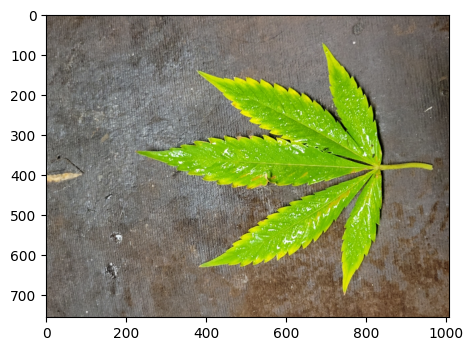

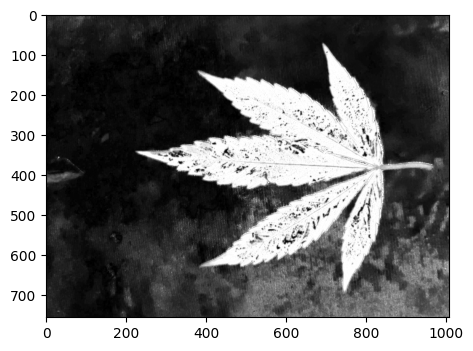

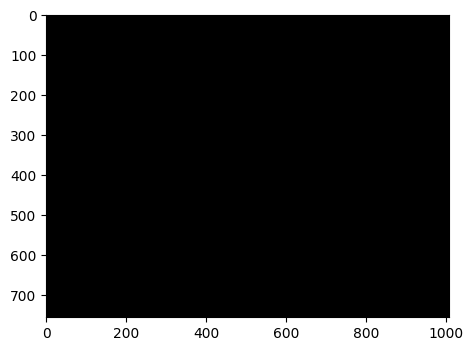

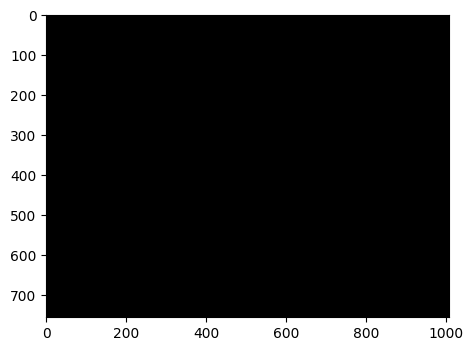

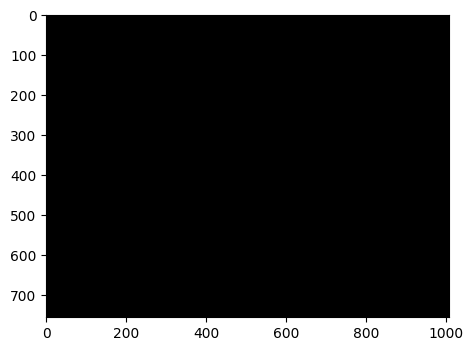

...

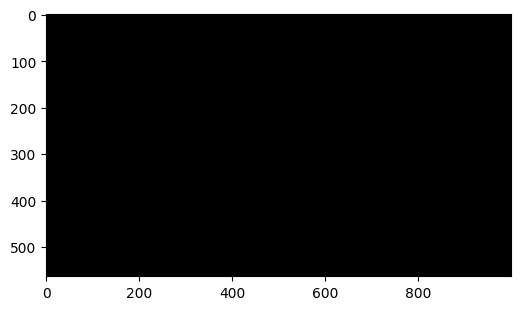

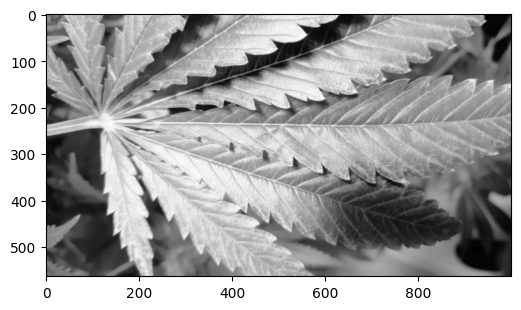

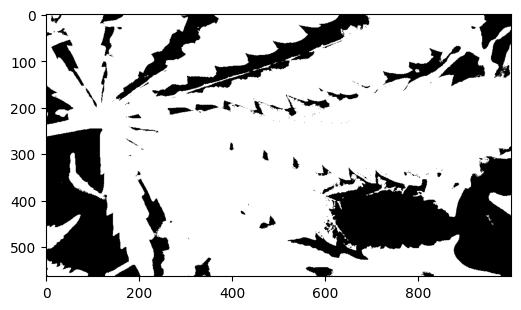

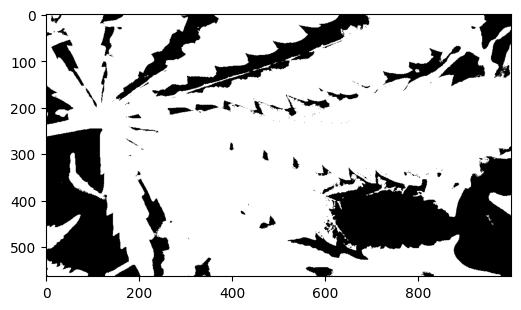

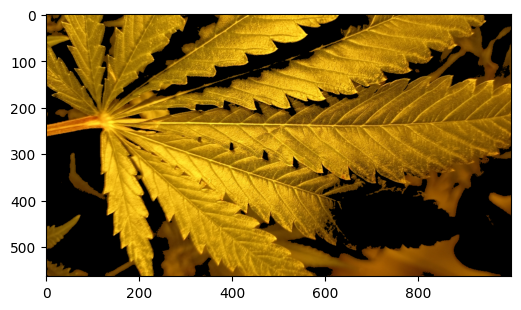

[ERROR] Failed to predict the colors...


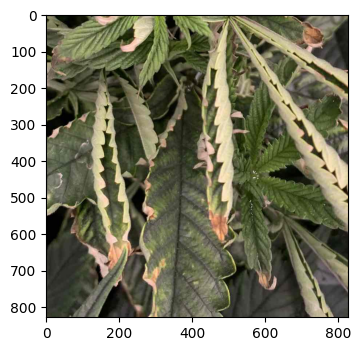

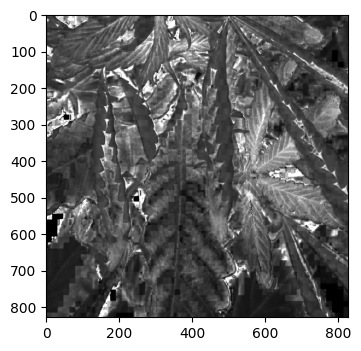

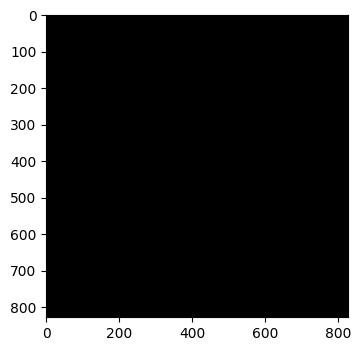

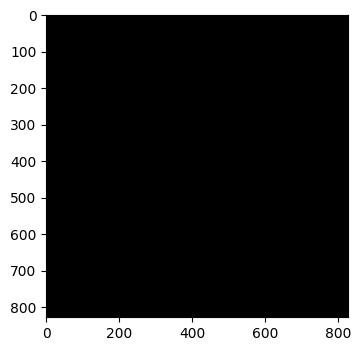

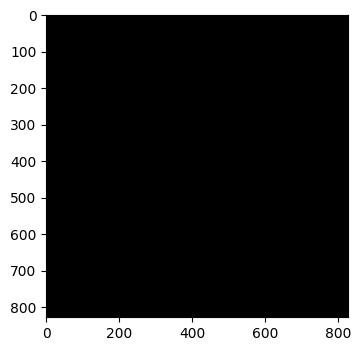

...

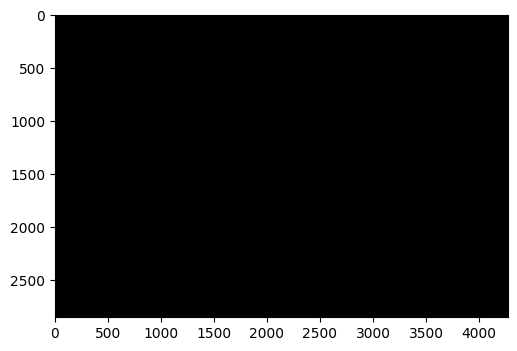

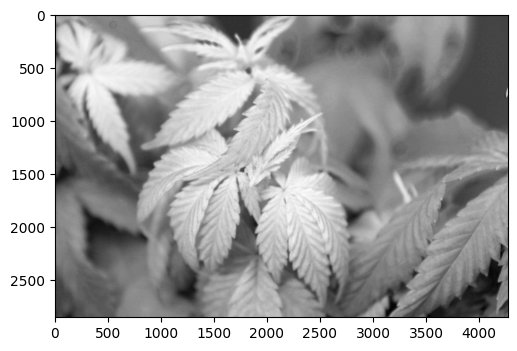

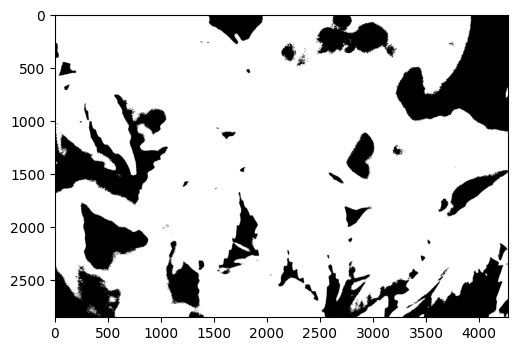

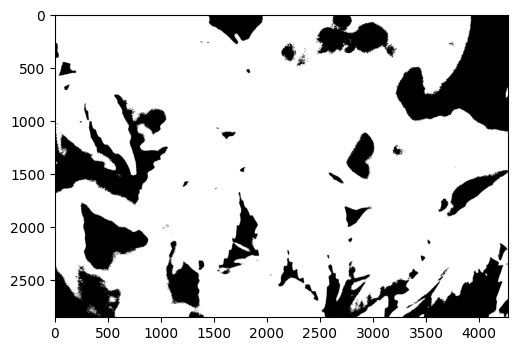

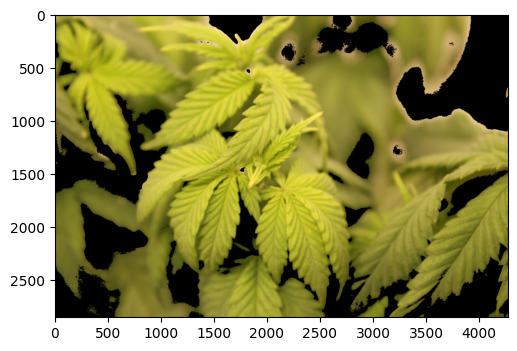

[ERROR] Failed to Mask off image or image foreground too big...


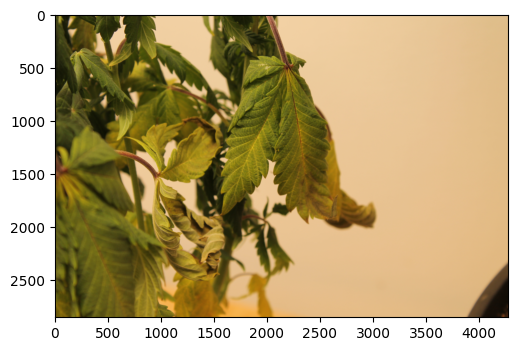

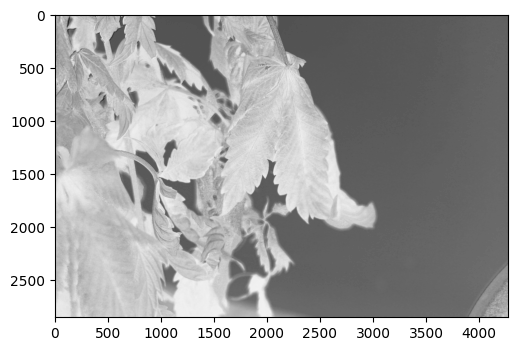

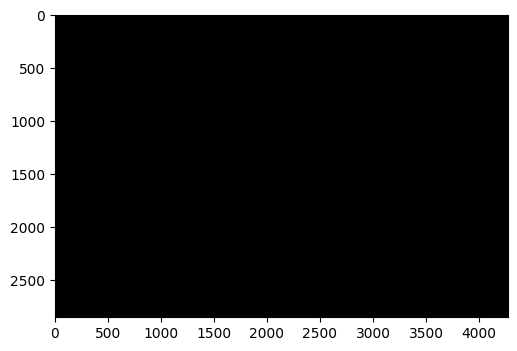

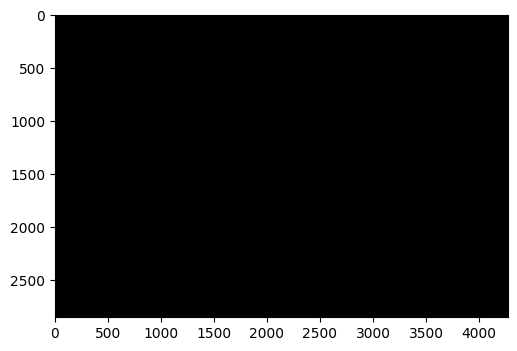

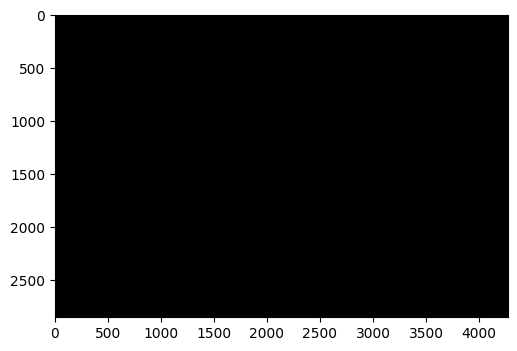

...

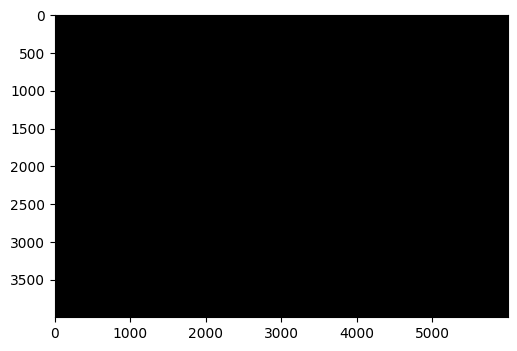

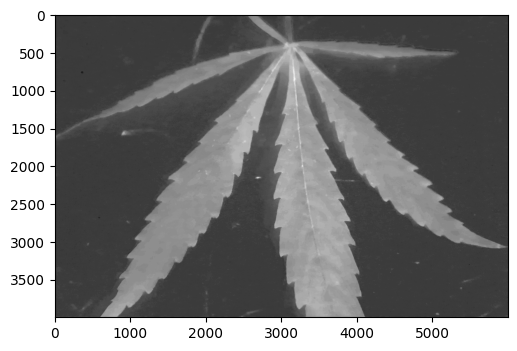

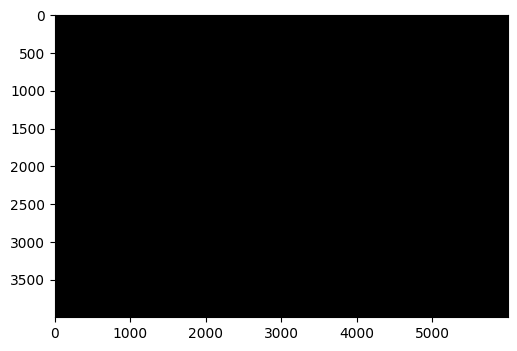

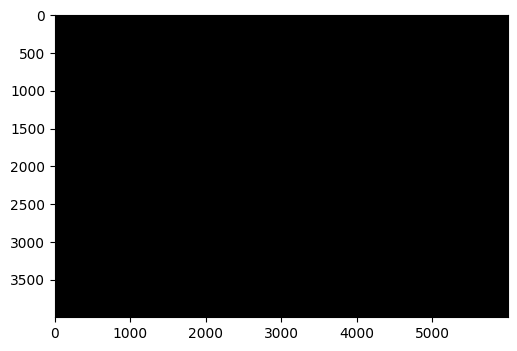

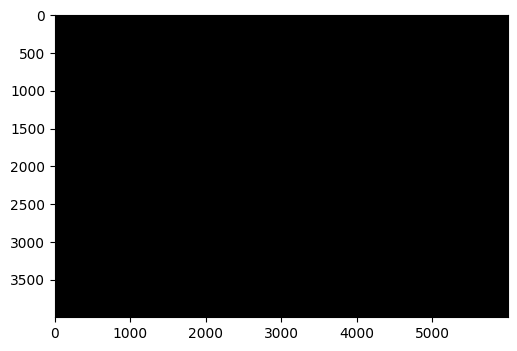

[ERROR] Failed to predict the colors...


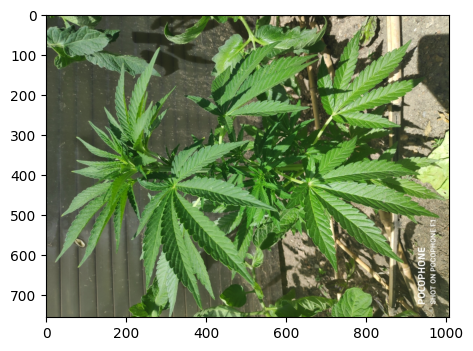

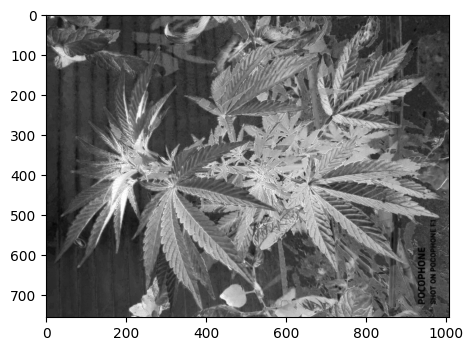

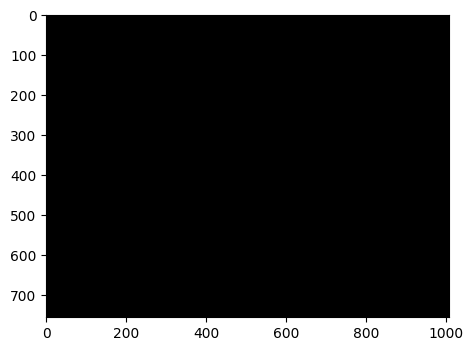

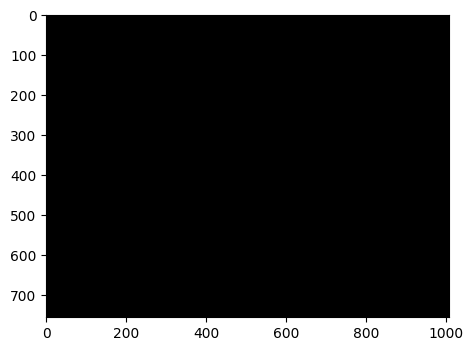

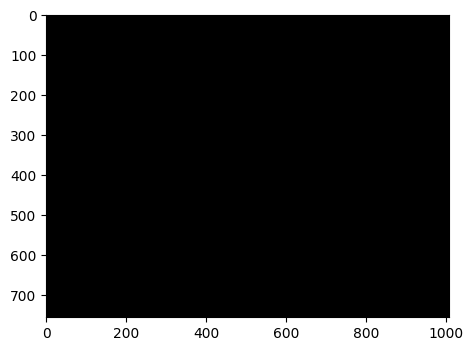

...

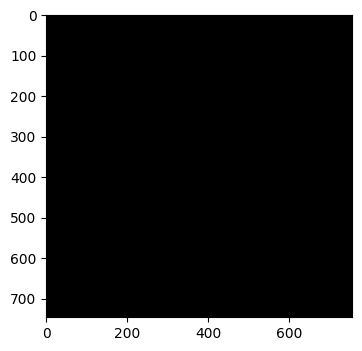

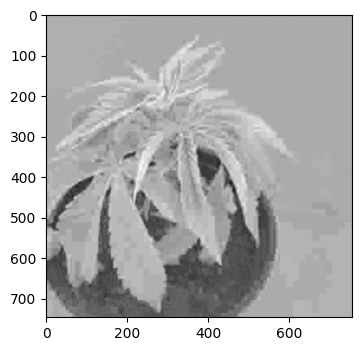

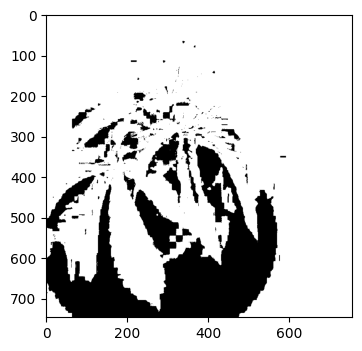

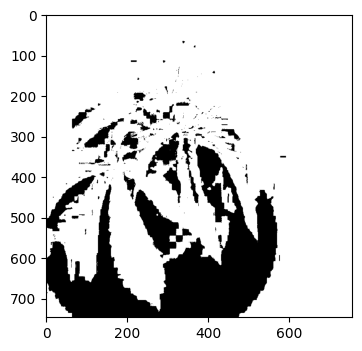

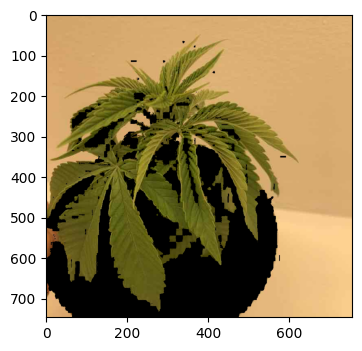

[ERROR] Failed to Mask off image or image foreground too big...


In [113]:
# Running the code for all the images present in the testing folder

import os
TESTING_IMAGE_FOLDER = "C:/Users/lifec/Desktop/Jobs/Coop/GrowDoc/testing_images"
for root, dirs, files in os.walk(TESTING_IMAGE_FOLDER):
    f = os.path.basename(root)
    
    file_names = []
    results = []
    failed_files = []
    warning_files = []

    # For every file, if black isn't the prominent color, it means the masking algorithm failed. Therefore, it appends the file name to the failed_files list
    for file in files:
        result = detect_colors(os.path.join(root, file))
        
        if(result == -1):
            failed_files.append(file)
        elif(result == -2):
            warning_files.append(file)
        else:
            file_names.append(file)
            results.append(detect_colors(os.path.join(root, file)))

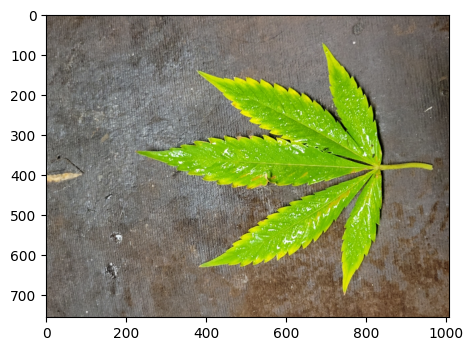

[('yellow', 2.6953354389194852), ('white', 0.32536067421080195), ('brown', 0), ('pink', 0)]: -----> {'MagnesiumDeficiency', 'SprayBurn', 'Viruses', 'CalciumDeficiency', 'BoronDeficiency', 'SulfurDeficiency', 'ZincDeficiency', 'Mutation', 'LightBurn', 'NutrientBurn', 'NutrientLockout', 'PotassiumDeficiency', 'RootRot', 'NitrogenDeficiency', 'IronDeficiency', 'Overwatering', 'PhFluctuation'}


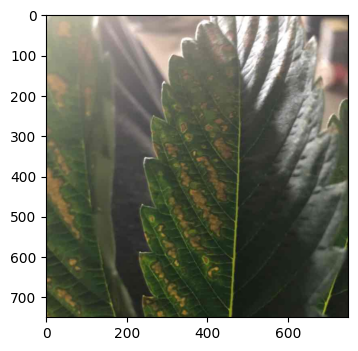

[('yellow', 106.98924731182795), ('brown', 2.031063321385902), ('white', 0), ('pink', 0)]: -----> {'MagnesiumDeficiency', 'SprayBurn', 'CalciumDeficiency', 'BoronDeficiency', 'SulfurDeficiency', 'ZincDeficiency', 'LightBurn', 'NutrientBurn', 'NutrientLockout', 'PhFluctuation', 'RootRot', 'Overwatering', 'PotassiumDeficiency'}


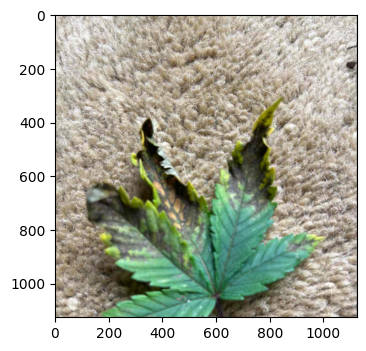

[('yellow', 40.294577784561376), ('white', 25.29095279887053), ('brown', 0.06868393940550235), ('pink', 0)]: -----> {'Mutation', 'LightBurn'}


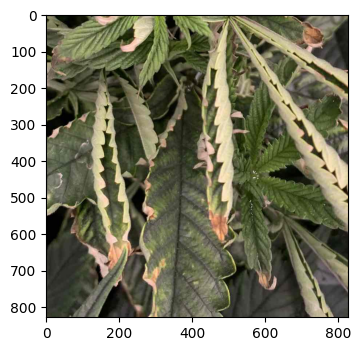

[('white', 54.88159534690487), ('yellow', 28.63869270184185), ('brown', 25.176568342334853), ('pink', 1.1355767899182938)]: -----> set()


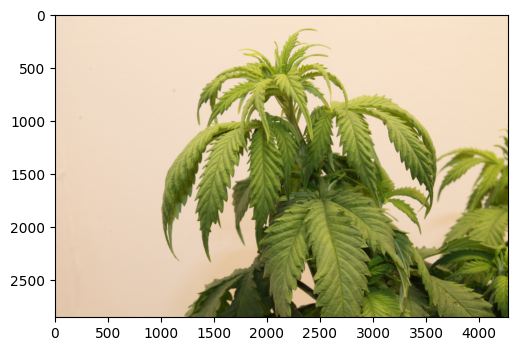

[('yellow', 62.936546086370804), ('white', 3.685256341564227), ('brown', 0), ('pink', 0)]: -----> {'Mutation', 'LightBurn'}


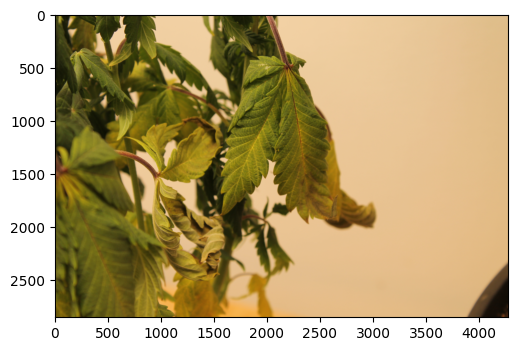

[('yellow', 2309614.186851211), ('white', 356432.17993079586), ('brown', 293433.91003460204), ('pink', 838.7543252595157)]: -----> set()


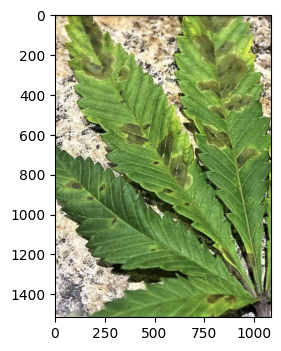

[('white', 2.2020019365305323), ('yellow', 0.08837387980569406), ('brown', 0.00011658823193363331), ('pink', 0)]: -----> {'SpiderMites', 'WhitePowderMildew', 'Mutation', 'LightBurn', 'Whiteflies', 'Thrips'}


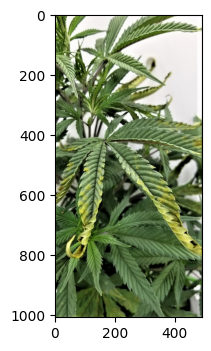

[('white', 15.718748158189427), ('yellow', 11.636313628415945), ('brown', 0), ('pink', 0)]: -----> {'Mutation', 'LightBurn'}


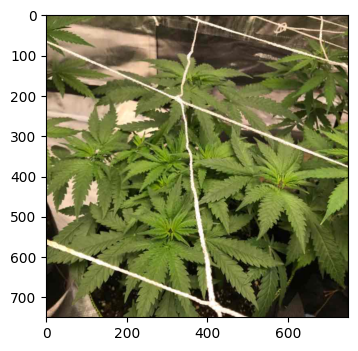

[('yellow', 0.6419990123092119), ('white', 0.16984589254478072), ('brown', 0.0), ('pink', 0)]: -----> []


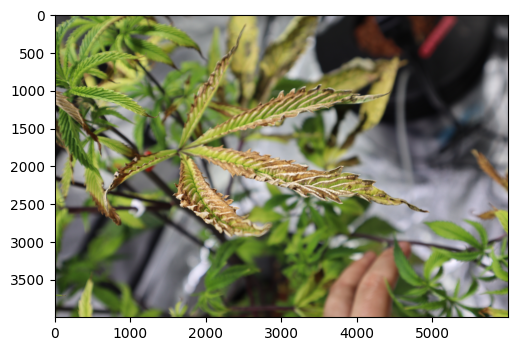

[('yellow', 41.976114373666576), ('white', 6.30755678501915), ('brown', 4.736936451788003), ('pink', 0.044259505172811166)]: -----> {'LightBurn'}


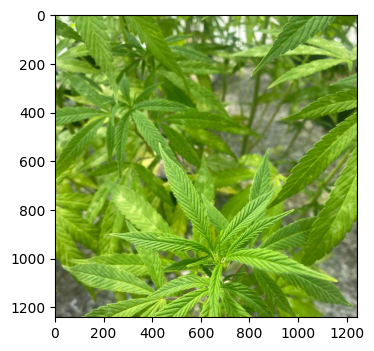

[('white', 0.8760992107837869), ('yellow', 0.05596266744019664), ('brown', 0), ('pink', 0)]: -----> []


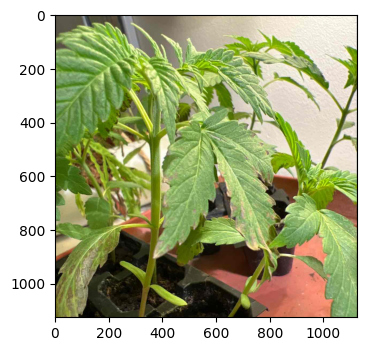

[('white', 25.81624785037909), ('yellow', 4.085435117326127), ('brown', 1.6539006954190878), ('pink', 1.1800719499706898)]: -----> set()


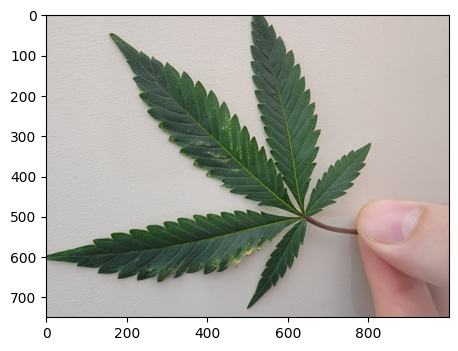

[('yellow', 3.7853107344632773), ('white', 0.6214689265536724), ('brown', 0), ('pink', 0)]: -----> {'MagnesiumDeficiency', 'SprayBurn', 'Viruses', 'CalciumDeficiency', 'BoronDeficiency', 'SulfurDeficiency', 'ZincDeficiency', 'Mutation', 'LightBurn', 'NutrientBurn', 'NutrientLockout', 'PotassiumDeficiency', 'RootRot', 'NitrogenDeficiency', 'IronDeficiency', 'Overwatering', 'PhFluctuation'}


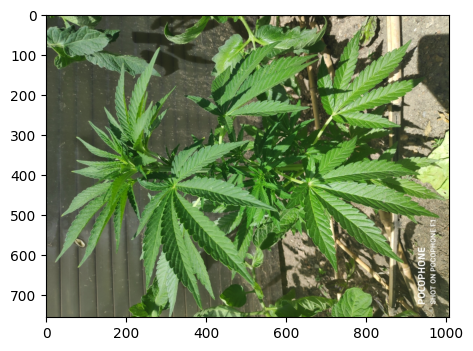

[('white', 6.427798896418143), ('yellow', 0.2516839336923019), ('brown', 0.0008698753468627946), ('pink', 0)]: -----> {'SpiderMites', 'WhitePowderMildew', 'Mutation', 'LightBurn', 'Whiteflies', 'Thrips'}


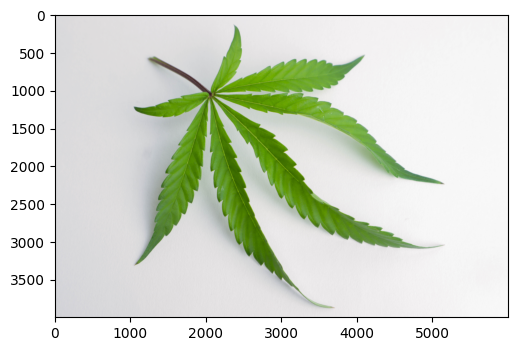

[('white', 0.20169710395100965), ('yellow', 0.0023786474309311686), ('brown', 0), ('pink', 0)]: -----> []


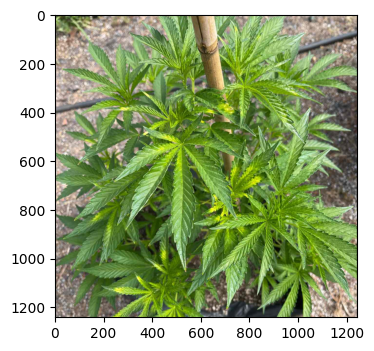

[('white', 5.043633965971971), ('yellow', 0.21454982675699436), ('brown', 0.0366525314164555), ('pink', 0)]: -----> {'SpiderMites', 'WhitePowderMildew', 'Mutation', 'LightBurn', 'Whiteflies', 'Thrips'}
############################
Working images --> ['1.jpg', '10.jpg', '11.jpg', '13.jpg', '14.jpg', '16.jpg', '17.jpg', '19.jpg', '2.jpg', '20.jpg', '3.jpg', '4.jpg', '5.jpg', '7.jpg', '8.jpg', '9.jpg']
Failed images --> ['12.jpg', '15.jpg', '6.jpg', 'exp10.jpg']


In [114]:
# Printing out the results and the possible deficiencies based upon the buckets list 

for i in range(len(file_names)):
#     print("{}: -----> {}, {}, {}".format(file_names[i], results[i][0][0][0], results[i][0][1][0], results[i][0][2][0]))
    image = plt.imread(os.path.join(root, file_names[i]))
    imgplot = plt.imshow(image)
    plt.show()
    print("{}: -----> {}".format(results[i][0], results[i][1])) # The results are in the percentage compared to the green as background

print("############################")
print("Working images --> {}".format(file_names))
print("Failed images --> {}".format(failed_files))
# print("Warning images --> {}".format(warning_files))

## Limitations

- PlantCV library sometimes not able to mask out the image and remove the background
- Some images have more white being detected because of reflection in the image
- Color range has limited range and may not detect the entire color pallette
- For bigger images, the code takes time to run and processing all pixels in the picture